In [ ]:


import pandas as pd
from google.colab import drive
drive.mount('/content/drive/')

import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler
from plotly.subplots import make_subplots
import numpy as np

# from catboost import Pool, cv

# https://www.kaggle.com/datasets/thedevastator/spotify-tracks-genre-dataset/data

music_data = pd.read_csv('/content/drive/MyDrive/online learning/projects/spotify_random_forest/train.csv')


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier  # Replace with your model

from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

<Axes: title={'center': 'Song Popularity by Most Popular Genres'}, xlabel='Track Genre', ylabel='Avg. Popularity'>

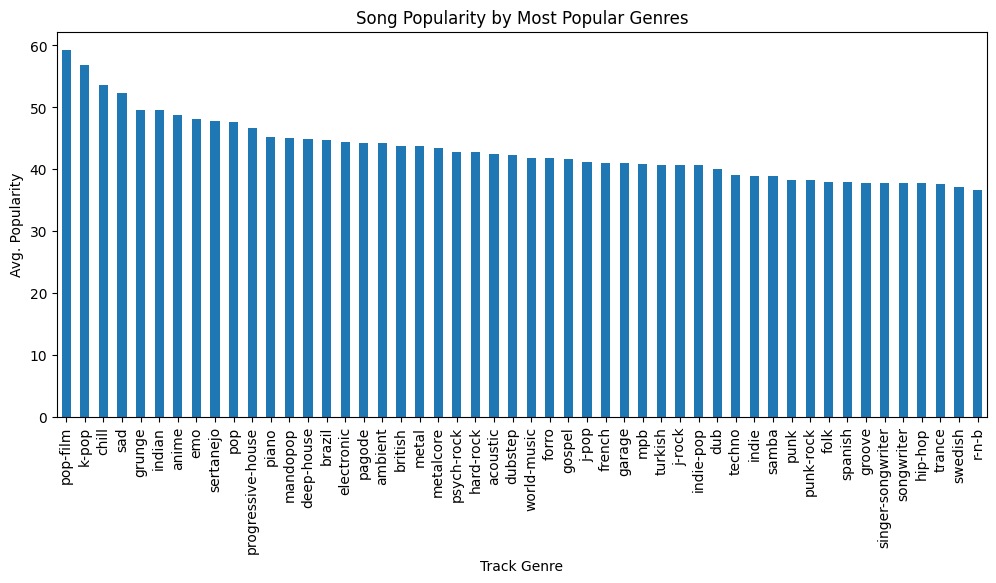

In [ ]:
import matplotlib.pyplot as plt

dfg = music_data.groupby(['track_genre'])['popularity'].mean().sort_values(ascending=False).head(50)

dfg.plot(kind='bar', title='Song Popularity by Most Popular Genres', ylabel='Avg. Popularity',
         xlabel='Track Genre', figsize=(12, 5))

<Axes: title={'center': 'Song Popularity by Least Popular Genres'}, xlabel='Track Genre', ylabel='Avg. Popularity'>

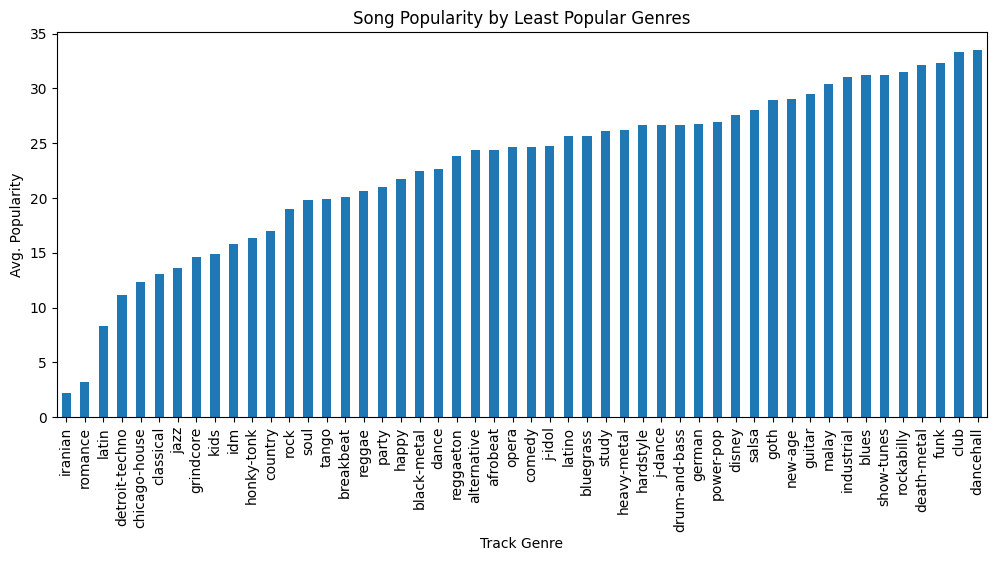

In [ ]:
dfg = music_data.groupby(['track_genre'])['popularity'].mean().sort_values(ascending=True).head(50)

dfg.plot(kind='bar', title='Song Popularity by Least Popular Genres', ylabel='Avg. Popularity',
         xlabel='Track Genre', figsize=(12, 5))

In [ ]:
## missing values
music_data.isnull().sum()

# df = df.dropna()

Unnamed: 0          0
track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [ ]:
### Credit: https://www.kaggle.com/code/thomasmann111111/spotify-eda-autoviz

na_cols=music_data.columns[music_data.isna().any()].tolist()

# Missing values summary
mv=pd.DataFrame(music_data[na_cols].isna().sum(), columns=['Number_missing'])

desc = pd.DataFrame(index = list(music_data))
desc['count'] = music_data.count()
desc['nunique'] = music_data.nunique()
desc['%unique'] = desc['nunique'] / len(music_data) * 100
desc['null'] = music_data.isnull().sum()
desc['Percentage_missing']=np.round(100*mv['Number_missing']/len(music_data),2)
desc['type'] = music_data.dtypes
desc = pd.concat([desc, music_data.describe().T.drop('count', axis = 1)], axis = 1)
desc

,count,nunique,%unique,null,Percentage_missing,type,mean,std,min,25%,50%,75%,max
Unnamed: 0,114000,114000,100.000000,0,NaN,int64,56999.500000,32909.109681,0.000,28499.75000,56999.500000,85499.2500,113999.000
track_id,114000,89741,78.720175,0,NaN,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
artists,113999,31437,27.576316,1,0.0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
album_name,113999,46589,40.867544,1,0.0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
track_name,113999,73608,64.568421,1,0.0,object,NaN,NaN,NaN,NaN,NaN,NaN,NaN
popularity,114000,101,0.088596,0,NaN,int64,33.238535,22.305078,0.000,17.00000,35.000000,50.0000,100.000
duration_ms,114000,50697,44.471053,0,NaN,int64,228029.153114,107297.712645,0.000,174066.00000,212906.000000,261506.0000,5237295.000
explicit,114000,2,0.001754,0,NaN,bool,NaN,NaN,NaN,NaN,NaN,NaN,NaN
danceability,114000,1174,1.029825,0,NaN,float64,0.566800,0.173542,0.000,0.45600,0.580000,0.6950,0.985
energy,114000,2083,1.827193,0,NaN,float64,0.641383,0.251529,0.000,0.47200,0.685000,0.8540,1.000


In [ ]:
features = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness']

# Plotting the distributions of these features
fig = go.Figure()
for feature in features:
    fig.add_trace(go.Box(y=music_data[feature], name=feature))

fig.update_layout(
    title="Distribution of Musical Features",
    yaxis_title="Feature Value",
    xaxis_title="Musical Features"
)

fig.show()

In [ ]:
### other distributions

def plot_histogram(data, x, y=None):
    """
    Plot a histogram with random colors using Plotly.

    Parameters:
    - data: DataFrame
    - x: str, column name for the x-axis
    - y: str, optional, column name for the y-axis (default is None)
    """
    # Check if y is provided for a 2D histogram
    if y:
        color_sequence = np.random.choice(px.colors.qualitative.Plotly, size=1)[0]
        fig = px.histogram(data, x=x, y=y, color_discrete_sequence=[color_sequence])
        fig.update_layout(title=f'2D Histogram of {x} and {y}', xaxis_title=x, yaxis_title=y, bargap=0.2, autosize=False, width=500, height=300)
    else:
        # Plot a 1D histogram with random colors
        color_sequence = np.random.choice(px.colors.qualitative.Plotly, size=1)[0]
        fig = px.histogram(data, x=x, color_discrete_sequence=[color_sequence])
        fig.update_layout(title=f'Histogram of {x}', xaxis_title=x, bargap=0.2, autosize=False, width=500, height=300)

    fig.show()


In [ ]:
plot_histogram(music_data, x='explicit')
plot_histogram(music_data, x='mode')
plot_histogram(music_data, x='track_genre')
plot_histogram(music_data, x='time_signature')
plot_histogram(music_data, x='key')
plot_histogram(music_data, x='tempo')
plot_histogram(music_data, x='popularity')
plot_histogram(music_data, x='duration')

In [ ]:
#### correlations

attributes = [
'danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'tempo', 'key', 'popularity'
]

# correlation matrix for the selected attributes
correlation_matrix = music_data[attributes].corr()

# heatmap to visualize the correlation matrix
fig = px.imshow(correlation_matrix,
                x=attributes,
                y=attributes,
                text_auto=True,
                aspect="auto",
                color_continuous_scale='Blues',
                title='Correlation of Musical Features')

# layout to put the x-axis labels at the bottom
fig.update_xaxes(side="bottom")

# Show the figure
fig.show()

In [ ]:
data = music_data[['popularity', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
 'liveness', 'valence', 'tempo', 'time_signature', 'track_genre']]

# data = music_data[['popularity', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
# 'liveness', 'valence', 'tempo', 'time_signature']]

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

dum_df = pd.get_dummies(data, columns=['explicit', 'track_genre'], prefix=["explicit_", "genre_"] )
# dum_df = pd.get_dummies(data, columns=['explicit'], prefix=["explicit_"] )

X = dum_df.loc[:, dum_df.columns != 'popularity']
y = dum_df.loc[:, dum_df.columns == 'popularity']

#create traing and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)


In [ ]:
###Gradient boosting example
# Import GradientBoostingRegressor
from sklearn.ensemble import GradientBoostingRegressor

# Instantiate gb
model = GradientBoostingRegressor(max_depth=4,
            n_estimators=200,
            random_state=2)

# Fit gb to the training set
model.fit(X_train, y_train)

# Predict test set labels
y_pred = model.predict(X_test)

# Import mean_squared_error as MSE
from sklearn.metrics import mean_squared_error as MSE

# Compute MSE
mse_test = MSE(y_test, y_pred)

# Compute RMSE
rmse_test = mse_test**(1/2)

# Print RMSE
print('Test set RMSE of gb: {:.3f}'.format(rmse_test))





# ### Stochastic Gradient Boosting Example
# # Import GradientBoostingRegressor
# from sklearn.ensemble import GradientBoostingRegressor

# # Instantiate sgbr
# sgbr = GradientBoostingRegressor(max_depth=4,
#             subsample=0.9,
#             max_features=0.75,
#             n_estimators=200,
#             random_state=2)

# # Fit sgbr to the training set
# sgbr.fit(X_train, y_train)

# # Predict test set labels
# y_pred = sgbr.predict(X_test)

# # Import mean_squared_error as MSE
# from sklearn.metrics import mean_squared_error as MSE

# # Compute test set MSE
# mse_test = MSE(y_test, y_pred)

# # Compute test set RMSE
# rmse_test = mse_test**(1/2)

# # Print rmse_test
# print('Test set RMSE of sgbr: {:.3f}'.format(rmse_test))

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



Test set RMSE of gb: 19.082


Testing performance
RMSE: 19.08
MAPE: 17342640482076928.00
R2: 0.27


<Axes: >

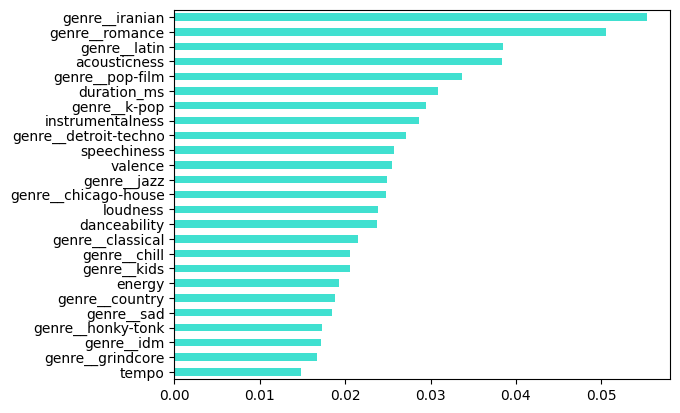

In [ ]:
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

pred = model.predict(X_test)
rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
mape = mean_absolute_percentage_error(y_test, pred)
print("Testing performance")
print('RMSE: {:.2f}'.format(rmse))
print('MAPE: {:.2f}'.format(mape))
print('R2: {:.2f}'.format(r2))

importances = pd.Series(data=model.feature_importances_,
                        index= X_train.columns)
importances_sorted = importances.sort_values()
importances_sorted.tail(25).plot(kind='barh', color='turquoise')

In [ ]:
##### how do predictions change with a boolean? Popular vs not

music_data['popularity_code'] = np.where(music_data['popularity'] < 35, 0, 1)
plot_histogram(music_data, x='popularity_code')

In [ ]:
# data = music_data[['popularity_code', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
#  'liveness', 'valence', 'tempo', 'time_signature', 'track_genre']]

data = music_data[['popularity_code', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
 'liveness', 'valence', 'tempo', 'time_signature']]

# dum_df = pd.get_dummies(data, columns=['explicit', 'track_genre'], prefix=["explicit_", "genre_"] )
dum_df = pd.get_dummies(data, columns=['explicit'], prefix=["explicit_"] )


X = dum_df.loc[:, dum_df.columns != 'popularity_code']
y = dum_df.loc[:, dum_df.columns == 'popularity_code']

#create traing and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

model = GradientBoostingClassifier(n_estimators=150, learning_rate=1.0, max_depth=10, random_state=13)
model.fit(X_train, y_train)
# model.score(X_test, y_test)

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



GradientBoostingClassifier(learning_rate=1.0, max_depth=10, n_estimators=150,
                           random_state=13)

In [ ]:
y_pred = model.predict(X_test)

model.score(X_test, y_test)

0.7457602339181286

In [ ]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix


# Generate the confusion matrix and classification report
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[12510  4672]
 [ 4023 12995]]
              precision    recall  f1-score   support

           0       0.76      0.73      0.74     17182
           1       0.74      0.76      0.75     17018

    accuracy                           0.75     34200
   macro avg       0.75      0.75      0.75     34200
weighted avg       0.75      0.75      0.75     34200



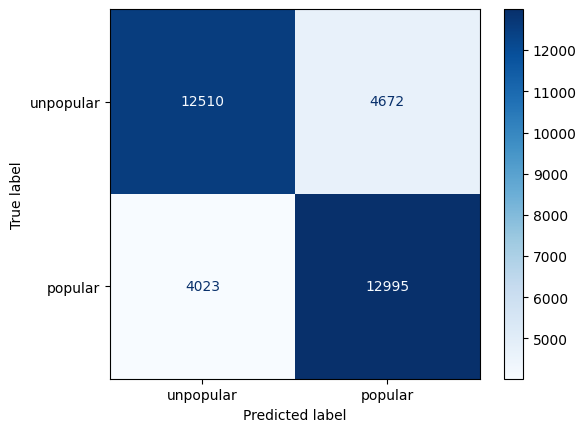

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Display the confusion matrix using ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred), display_labels=["unpopular", "popular"])
disp.plot(cmap="Blues", values_format="d")
plt.show()


In [ ]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier  # Replace with your model

# Create a sample dataset and labels
X = your_features  # Your feature matrix
y = your_labels  # Your target variable

# Create a k-fold cross-validation object
kfold = KFold(n_splits=5, shuffle=True, random_state=42)  # Adjust n_splits as needed

# Create your machine learning model (replace with your actual model)
model = RandomForestClassifier()  # Replace with your model

# Perform k-fold cross-validation
results = cross_val_score(model, X, y, cv=kfold)

# Print the cross-validation results
print("Cross-Validation Results: ", results)
print("Mean Accuracy: {:.2f}%".format(results.mean() * 100))


Name: scikit-learn
Version: 1.2.2
Summary: A set of python modules for machine learning and data mining
Home-page: http://scikit-learn.org
Author: 
Author-email: 
License: new BSD
Location: /usr/local/lib/python3.10/dist-packages
Requires: joblib, numpy, scipy, threadpoolctl
Required-by: bigframes, fastai, imbalanced-learn, librosa, mlxtend, qudida, sklearn-pandas, yellowbrick


<Axes: >

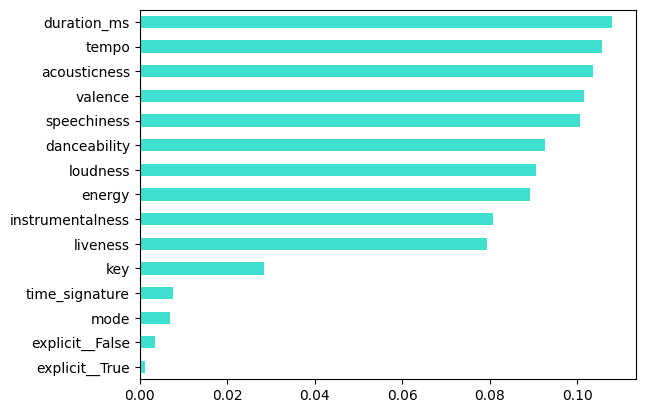

In [ ]:
importances = pd.Series(data=model.feature_importances_,
                        index= X_train.columns)
importances_sorted = importances.sort_values()
importances_sorted.tail(25).plot(kind='barh', color='turquoise')

In [ ]:
from sklearn.inspection import permutation_importance

# Calculate permutation importances
result = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
importances = result.importances_mean

In [ ]:
importances_sorted = importances.sort_values()
importances_sorted.tail(25).plot(kind='barh', color='turquoise')

In [ ]:
list(X)

['duration_ms',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'explicit__False',
 'explicit__True',
 'genre__acoustic',
 'genre__afrobeat',
 'genre__alt-rock',
 'genre__alternative',
 'genre__ambient',
 'genre__anime',
 'genre__black-metal',
 'genre__bluegrass',
 'genre__blues',
 'genre__brazil',
 'genre__breakbeat',
 'genre__british',
 'genre__cantopop',
 'genre__chicago-house',
 'genre__children',
 'genre__chill',
 'genre__classical',
 'genre__club',
 'genre__comedy',
 'genre__country',
 'genre__dance',
 'genre__dancehall',
 'genre__death-metal',
 'genre__deep-house',
 'genre__detroit-techno',
 'genre__disco',
 'genre__disney',
 'genre__drum-and-bass',
 'genre__dub',
 'genre__dubstep',
 'genre__edm',
 'genre__electro',
 'genre__electronic',
 'genre__emo',
 'genre__folk',
 'genre__forro',
 'genre__french',
 'genre__funk',
 'genre__garage',
 'genre__german',
 'genre_

In [ ]:
importances_sorted.tail()

acousticness    0.057821
valence         0.057906
speechiness     0.060100
tempo           0.061911
duration_ms     0.065043
dtype: float64

In [ ]:
!pip install lime
from lime import lime_tabular


explainer = lime_tabular.LimeTabularExplainer(X.astype(int).values,
mode='classification',training_labels=y,feature_names=model.feature_names_in_)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=343b6d080f9f27762c3c459692ed81a067811d39039f1e5d97c2478468a7c9b0
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
def prob(X):
    return np.array(list(zip(1-model.predict(X),model.predict(X))))

In [ ]:
y.head()

,popularity_code
0,1
1,1
2,1
3,1
4,1


In [ ]:
# # asking for explanation for LIME model

feat = list(X)
# feat = ['acousticness', 'valence', 'speechiness', 'tempo', 'duration_ms']

i = 4
exp = explainer.explain_instance(X.loc[i,feat].astype(int), prob, num_features=25)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names



In [ ]:
X=X.head()

In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
X=X.head()

In [ ]:
# Code for SP-LIME
import warnings
from lime import submodular_pick

# Remember to convert the dataframe to matrix values
# SP-LIME returns exaplanations on a sample set to provide a non redundant global decision boundary of original model
sp_obj = submodular_pick.SubmodularPick(explainer, X[model.feature_names_in_].values, \
prob, num_features=5,num_exps_desired=10)

[exp.as_pyplot_figure(label=1) for exp in sp_obj.sp_explanations]

In [ ]:
[exp.show_in_notebook() for exp in sp_obj.sp_explanations]

[None, None, None, None, None]

In [ ]:
music_data.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,popularity_code
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic,1
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic,1
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic,1
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic,1
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic,1


In [ ]:
# !pip install catboost
import catboost as cb
from catboost import CatBoostRegressor, Pool



dataframe = music_data[['popularity', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
 'liveness', 'valence', 'tempo', 'time_signature', 'track_genre']]

X = dataframe.loc[:, dataframe.columns != 'popularity']
y = dataframe.loc[:, dataframe.columns == 'popularity']

#create traing and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)

categorical_features = ['explicit', 'track_genre']

train_dataset = Pool(X_train, y_train, categorical_features)
test_dataset = Pool(X_test, y_test, categorical_features)

# RMSEWithUncertainty


model = cb.CatBoostRegressor(loss_function='RMSE')

# grid = {'iterations': [300, 400, 500],
#         'learning_rate': [0.03, 0.1, 0.2],
#         'depth': [6, 8, 10],
#         'l2_leaf_reg': [3, 4, 5]}

grid = {'iterations': [500],
        'learning_rate': [0.03, 0.1],
        'depth': [6],
        'l2_leaf_reg': [4, 5]}

model.grid_search(grid, train_dataset)

Testing performance
RMSE: 17.97
MAPE: 15488069181308280.00
R2: 0.35


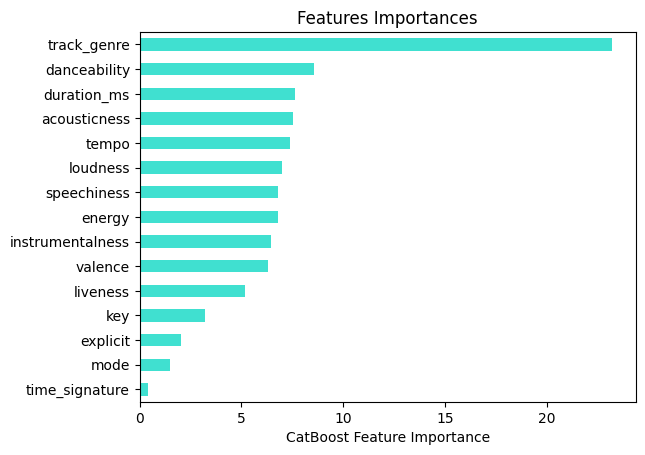

In [ ]:
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

pred = model.predict(X_test)
rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
mape = mean_absolute_percentage_error(y_test, pred)
print("Testing performance")
print('RMSE: {:.2f}'.format(rmse))
print('MAPE: {:.2f}'.format(mape))
print('R2: {:.2f}'.format(r2))

importances = pd.Series(data=model.feature_importances_,
                        index= X_train.columns)
importances_sorted = importances.sort_values()
importances_sorted.plot(kind='barh', color='turquoise')
plt.xlabel("CatBoost Feature Importance")
plt.title('Features Importances')
plt.show()

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

model.get_all_params()

summary = model.select_features(
    train_dataset,
    eval_set=test_dataset,
    features_for_select='0-14',
    num_features_to_select=10,
    steps=3,
    train_final_model=False,
    logging_level='Silent',
    plot=True
)

summary

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

{'selected_features': [0, 2, 3, 5, 7, 8, 9, 11, 12, 14],
 'eliminated_features_names': ['time_signature',
  'mode',
  'key',
  'explicit',
  'liveness'],
 'loss_graph': {'main_indices': [0, 2, 4],
  'removed_features_count': [0, 1, 2, 3, 4, 5],
  'loss_values': [17.969203695680644,
   17.975064308922278,
   17.988533355361543,
   18.02674255011112,
   18.078234302074264,
   18.152084131674677]},
 'eliminated_features': [13, 6, 4, 1, 10],
 'selected_features_names': ['duration_ms',
  'danceability',
  'energy',
  'loudness',
  'speechiness',
  'acousticness',
  'instrumentalness',
  'valence',
  'tempo',
  'track_genre']}

In [ ]:
categorical_features_indices = [1, 14]

def log_loss(m, X, y):
    return metrics.log_loss(y,m.predict_proba(X)[:,1])

def permutation_importances(model, X, y, metric):
    baseline = metric(model, X, y)
    imp = []
    for col in X.columns:
        save = X[col].copy()
        X[col] = np.random.permutation(X[col])
        m = metric(model, X, y)
        X[col] = save
        imp.append(m-baseline)
    return np.array(imp)

def get_feature_imp_plot(method):

    if method == "Permutation":
        fi =  permutation_importances(model, X_test, y_test, log_loss)

    elif method == "Baseline":
        fi = baseline_importance(model, X_train, y_train, X_test, y_test, log_loss)

    elif method == "ShapeValues":
        shap_values = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type="ShapValues")
        shap_values = shap_values[:,:-1]
        shap.summary_plot(shap_values, X_test)

    else:
        fi = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type=method)

    if method != "ShapeValues":
        feature_score = pd.DataFrame(list(zip(X_test.dtypes.index, fi )),
                                        columns=['Feature','Score'])

        feature_score = feature_score.sort_values(by='Score', ascending=False, inplace=False, kind='quicksort', na_position='last')

        plt.rcParams["figure.figsize"] = (12,7)
        ax = feature_score.plot('Feature', 'Score', kind='bar', color='c')
        ax.set_title("Feature Importance using {}".format(method), fontsize = 14)
        ax.set_xlabel("features")
        plt.show()

In [ ]:
model.feature_names_

['duration_ms',
 'explicit',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'track_genre']

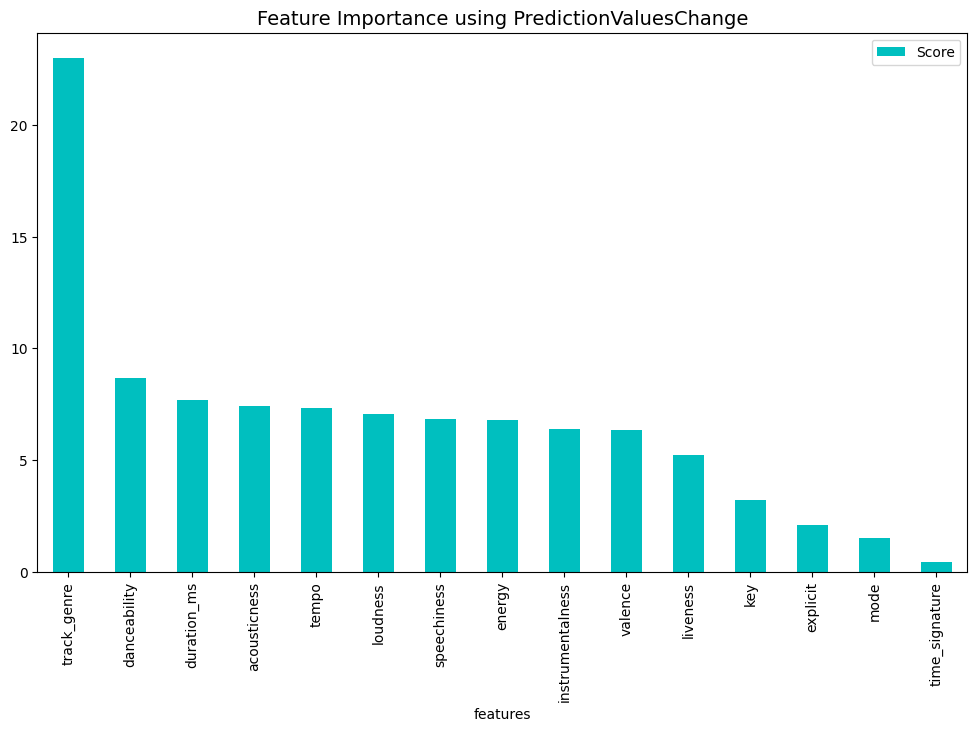

None


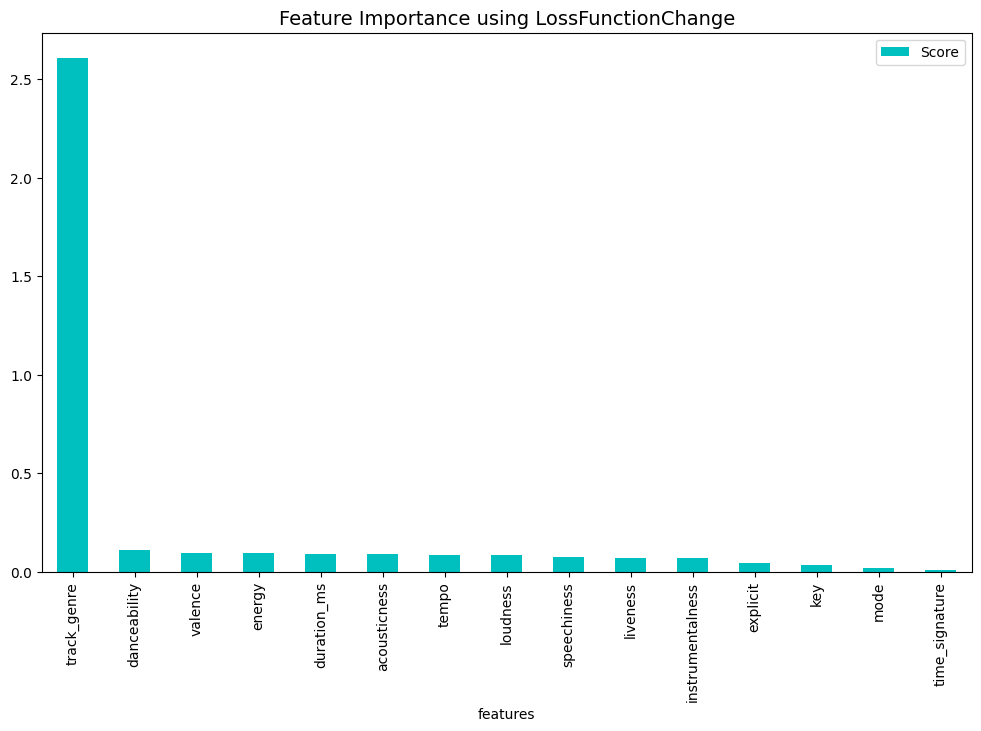

None


<ipython-input-26-f6599f1e19b6>:10: FutureWarning:

Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.

<ipython-input-26-f6599f1e19b6>:11: FutureWarning:

Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.



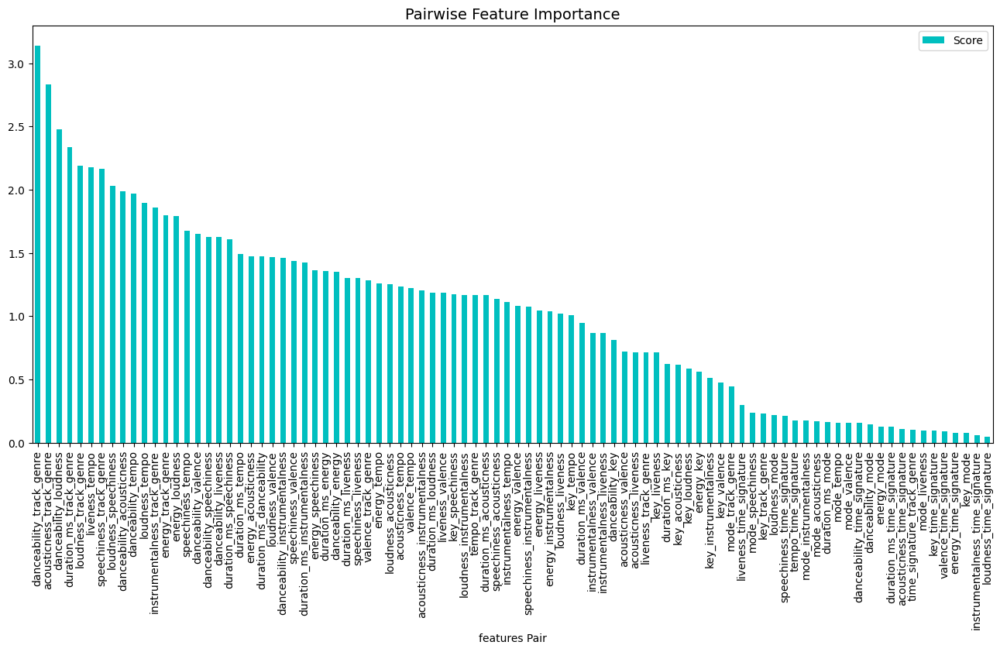

In [ ]:
print(get_feature_imp_plot(method="PredictionValuesChange"))

print(get_feature_imp_plot(method="LossFunctionChange"))

fi = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type="Interaction")

fi_new = []
for k,item in enumerate(fi):
    first = X_test.dtypes.index[fi[k][0]]
    second = X_test.dtypes.index[fi[k][1]]
    if first != second:
        fi_new.append([first + "_" + second, fi[k][2]])

feature_score = pd.DataFrame(fi_new,columns=['Feature-Pair','Score'])

feature_score = feature_score.sort_values(by='Score', ascending=False, inplace=False, kind='quicksort', na_position='last')
plt.rcParams["figure.figsize"] = (16,7)
ax = feature_score.plot('Feature-Pair', 'Score', kind='bar', color='c')
ax.set_title("Pairwise Feature Importance", fontsize = 14)
ax.set_xlabel("features Pair")
plt.show()

In [ ]:
from catboost import CatBoostClassifier



dataframe = music_data[['popularity_code', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
 'liveness', 'valence', 'tempo', 'time_signature', 'track_genre']]

X = dataframe.loc[:, dataframe.columns != 'popularity_code']
y = dataframe.loc[:, dataframe.columns == 'popularity_code']

#create traing and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)

categorical_features = ['explicit', 'track_genre']

train_dataset = Pool(X_train, y_train, categorical_features)
test_dataset = Pool(X_test, y_test, categorical_features)


model = cb.CatBoostClassifier()

In [ ]:
grid = {'iterations': [500, 800],
        'learning_rate': [0.03, 0.1],
        'depth': [6, 8],
        'l2_leaf_reg': [4, 5]}

model.grid_search(grid, train_dataset)

[[14031  3151]
 [ 3038 13980]]
              precision    recall  f1-score   support

           0       0.82      0.82      0.82     17182
           1       0.82      0.82      0.82     17018

    accuracy                           0.82     34200
   macro avg       0.82      0.82      0.82     34200
weighted avg       0.82      0.82      0.82     34200



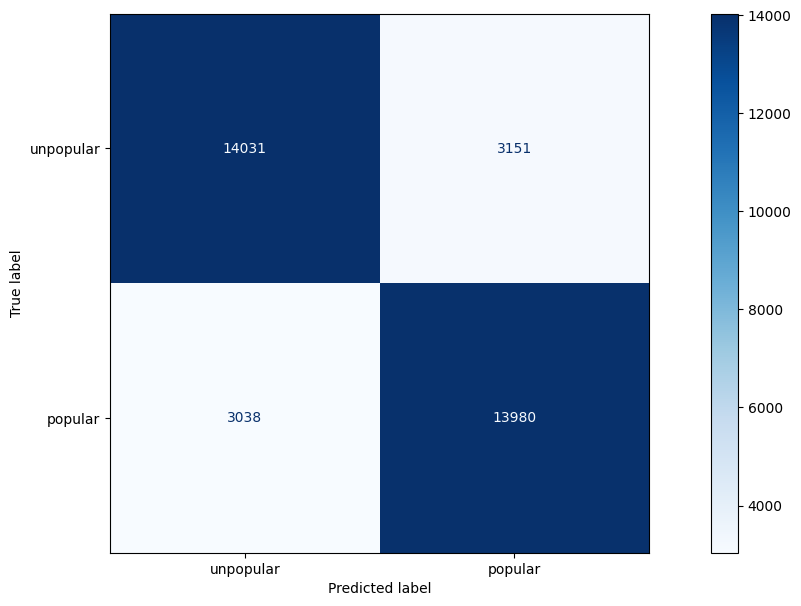

In [ ]:

y_pred = model.predict(X_test)

# Generate the confusion matrix and classification report
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# Display the confusion matrix using ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred), display_labels=["unpopular", "popular"])
disp.plot(cmap="Blues", values_format="d")
plt.show()

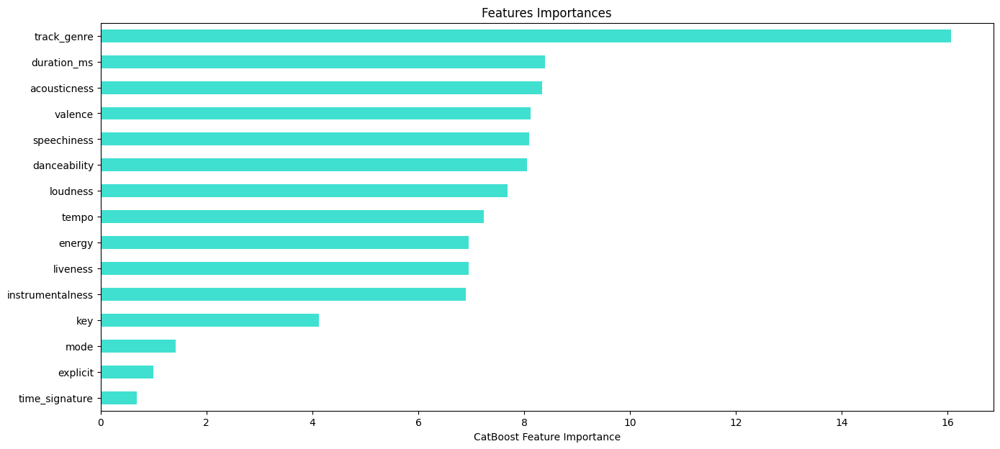

In [ ]:
importances = pd.Series(data=model.feature_importances_,
                        index= X_train.columns)
importances_sorted = importances.sort_values()
importances_sorted.plot(kind='barh', color='turquoise')
plt.xlabel("CatBoost Feature Importance")
plt.title('Features Importances')
plt.show()

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

model.get_all_params()

summary = model.select_features(
    train_dataset,
    eval_set=test_dataset,
    features_for_select='0-14',
    num_features_to_select=10,
    steps=3,
    train_final_model=False,
    logging_level='Silent',
    plot=True
)

summary

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

{'selected_features': [0, 2, 3, 5, 7, 8, 9, 11, 12, 14],
 'eliminated_features_names': ['time_signature',
  'mode',
  'explicit',
  'key',
  'liveness'],
 'loss_graph': {'main_indices': [0, 2, 4],
  'removed_features_count': [0, 1, 2, 3, 4, 5],
  'loss_values': [0.3993598151074951,
   0.39988326307016897,
   0.4009073212576846,
   0.4024465372214034,
   0.4044726105880437,
   0.4071550814346897]},
 'eliminated_features': [13, 6, 1, 4, 10],
 'selected_features_names': ['duration_ms',
  'danceability',
  'energy',
  'loudness',
  'speechiness',
  'acousticness',
  'instrumentalness',
  'valence',
  'tempo',
  'track_genre']}

In [ ]:
model.get_all_params()

{'nan_mode': 'Min',
 'eval_metric': 'Logloss',
 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1',
  'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'],
 'iterations': 800,
 'sampling_frequency': 'PerTree',
 'fold_permutation_block': 0,
 'leaf_estimation_method': 'Newton',
 'random_score_type': 'NormalWithModelSizeDecrease',
 'counter_calc_method': 'SkipTest',
 'grow_policy': 'SymmetricTree',
 'penalties_coefficient': 1,
 'boosting_type': 'Plain',
 'model_shrink_mode': 'Constant',
 'feature_border_type': 'GreedyLogSum',
 'ctr_leaf_count_limit': 18446744073709551615,
 'bayesian_matrix_reg': 0.10000000149011612,
 'one_hot_max_size': 2,
 'eval_fraction': 0,
 'force_unit_auto_pair_weights': False,
 'l2_leaf_reg': 4,
 'random_strength': 1,
 'rsm': 1,
 'boost_from_average': False,
 'max_ctr_complexity': 4,
 'model_size_reg': 0.5,
 'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderT

In [ ]:
# dataframe = music_data[['popularity_code', 'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
#  'liveness', 'valence', 'tempo', 'time_signature', 'track_genre']]

dataframe = music_data[['popularity_code', 'duration_ms', 'danceability', 'energy', 'key', 'loudness', 'speechiness', 'acousticness', 'instrumentalness',
 'liveness', 'valence', 'tempo', 'track_genre']]


X = dataframe.loc[:, dataframe.columns != 'popularity_code']
y = dataframe.loc[:, dataframe.columns == 'popularity_code']

#create traing and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)

categorical_features = ['track_genre']

train_dataset = Pool(X_train, y_train, categorical_features)
test_dataset = Pool(X_test, y_test, categorical_features)


model = cb.CatBoostClassifier()

grid = {'iterations': [800],
        'learning_rate': [0.1],
        'depth': [8],
        'l2_leaf_reg': [4]}

model.grid_search(grid, train_dataset)

[[13996  3186]
 [ 3086 13932]]
              precision    recall  f1-score   support

           0       0.82      0.81      0.82     17182
           1       0.81      0.82      0.82     17018

    accuracy                           0.82     34200
   macro avg       0.82      0.82      0.82     34200
weighted avg       0.82      0.82      0.82     34200



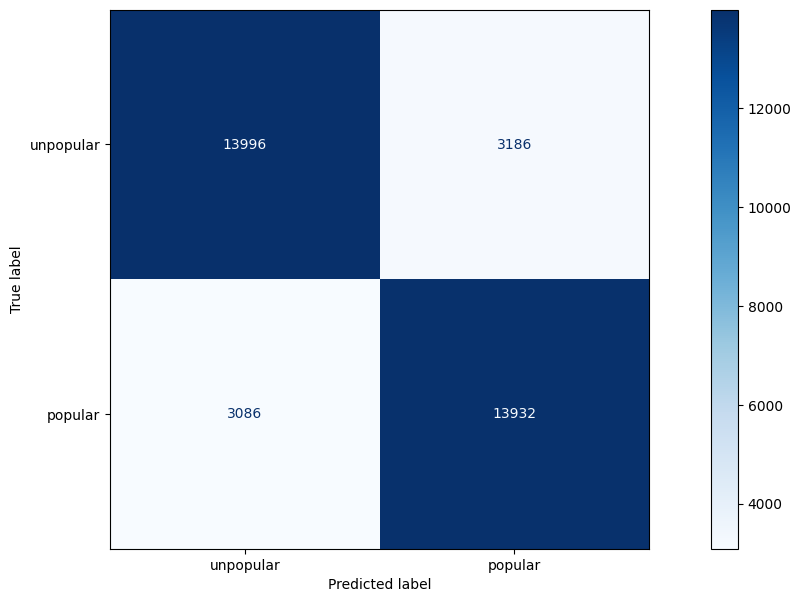

In [ ]:
y_pred = model.predict(X_test)

# Generate the confusion matrix and classification report
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# Display the confusion matrix using ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred), display_labels=["unpopular", "popular"])
disp.plot(cmap="Blues", values_format="d")
plt.show()

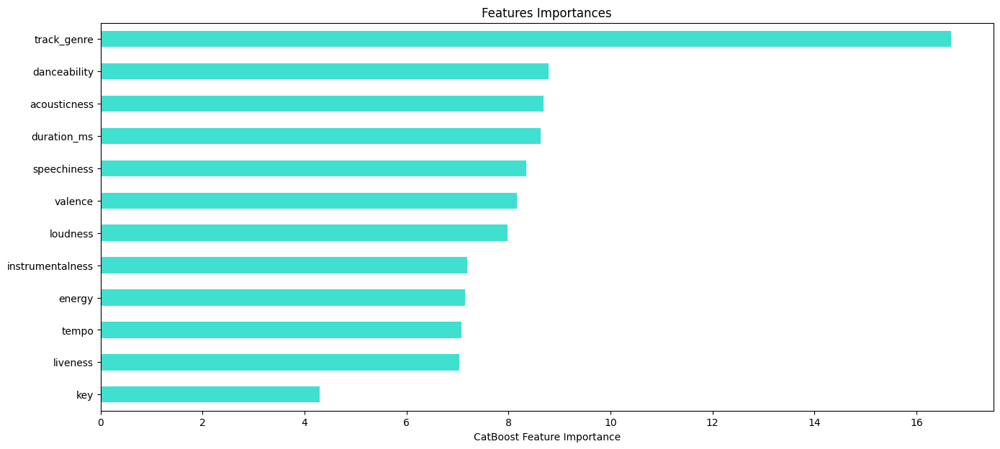

In [ ]:
importances = pd.Series(data=model.feature_importances_,
                        index= X_train.columns)
importances_sorted = importances.sort_values()
importances_sorted.plot(kind='barh', color='turquoise')
plt.xlabel("CatBoost Feature Importance")
plt.title('Features Importances')
plt.show()

In [ ]:
categorical_features_indices = [11]

def permutation_importances(model, X, y, metric):
    baseline = metric(model, X, y)
    imp = []
    for col in X.columns:
        save = X[col].copy()
        X[col] = np.random.permutation(X[col])
        m = metric(model, X, y)
        X[col] = save
        imp.append(m-baseline)
    return np.array(imp)

def get_feature_imp_plot(method):

    if method == "ShapeValues":
        shap_values = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type="ShapValues")
        shap_values = shap_values[:,:-1]
        shap.summary_plot(shap_values, X_test)

    else:
        fi = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type=method)

    if method != "ShapeValues":
        feature_score = pd.DataFrame(list(zip(X_test.dtypes.index, fi )),
                                        columns=['Feature','Score'])

        feature_score = feature_score.sort_values(by='Score', ascending=False, inplace=False, kind='quicksort', na_position='last')

        plt.rcParams["figure.figsize"] = (12,7)
        ax = feature_score.plot('Feature', 'Score', kind='bar', color='c')
        ax.set_title("Feature Importance using {}".format(method), fontsize = 14)
        ax.set_xlabel("features")
        plt.show()

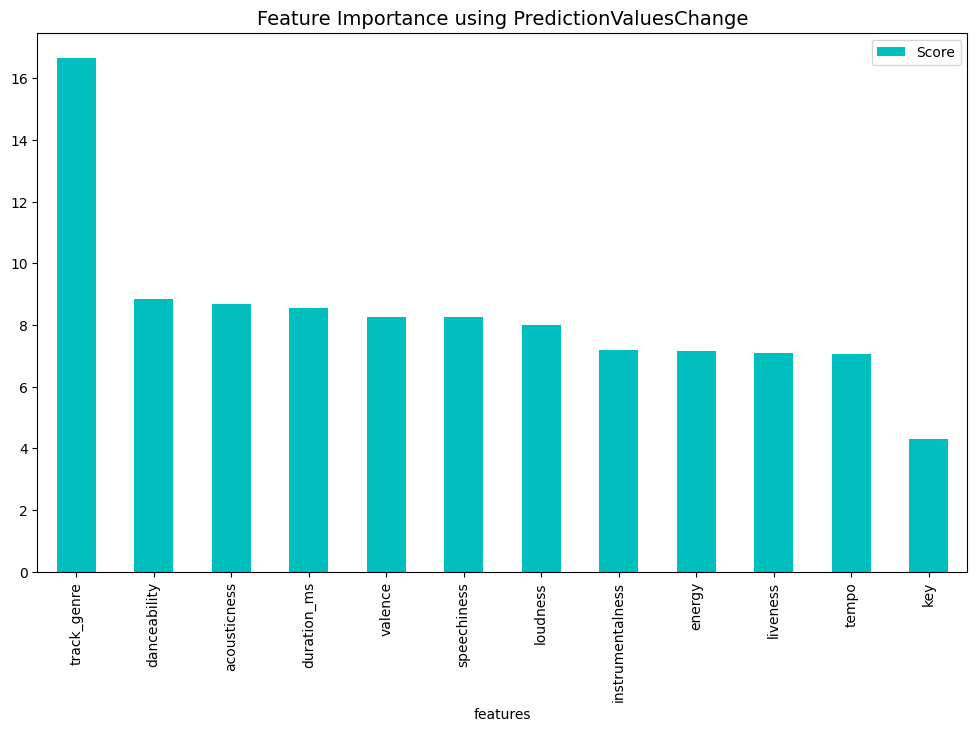

None


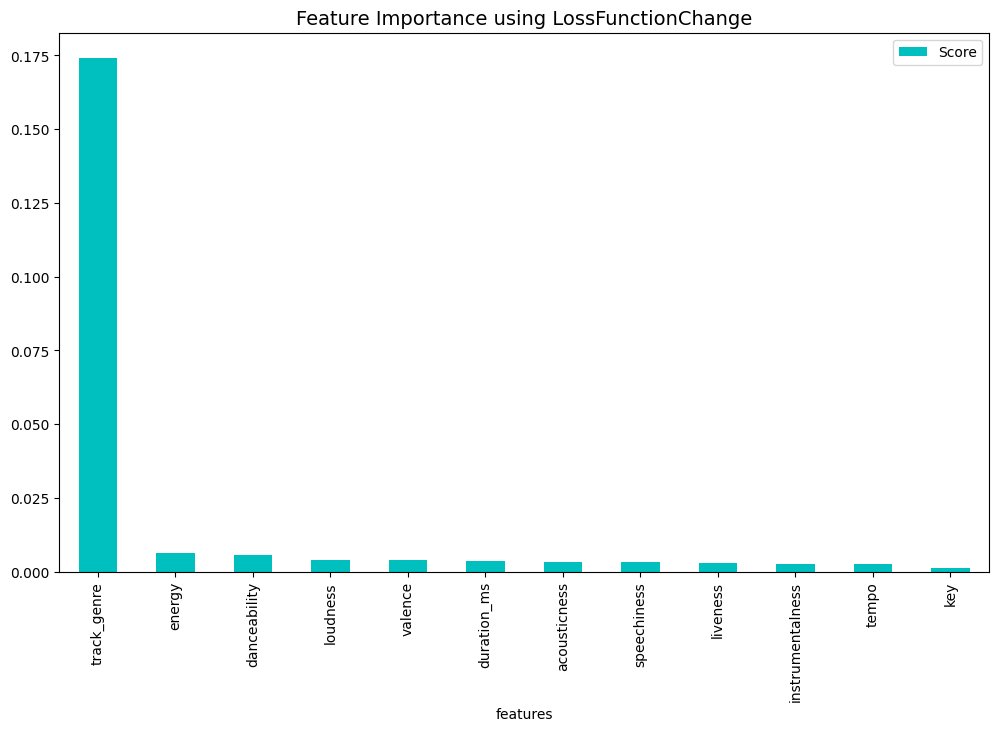

None


<ipython-input-47-f6599f1e19b6>:10: FutureWarning:

Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.

<ipython-input-47-f6599f1e19b6>:11: FutureWarning:

Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.



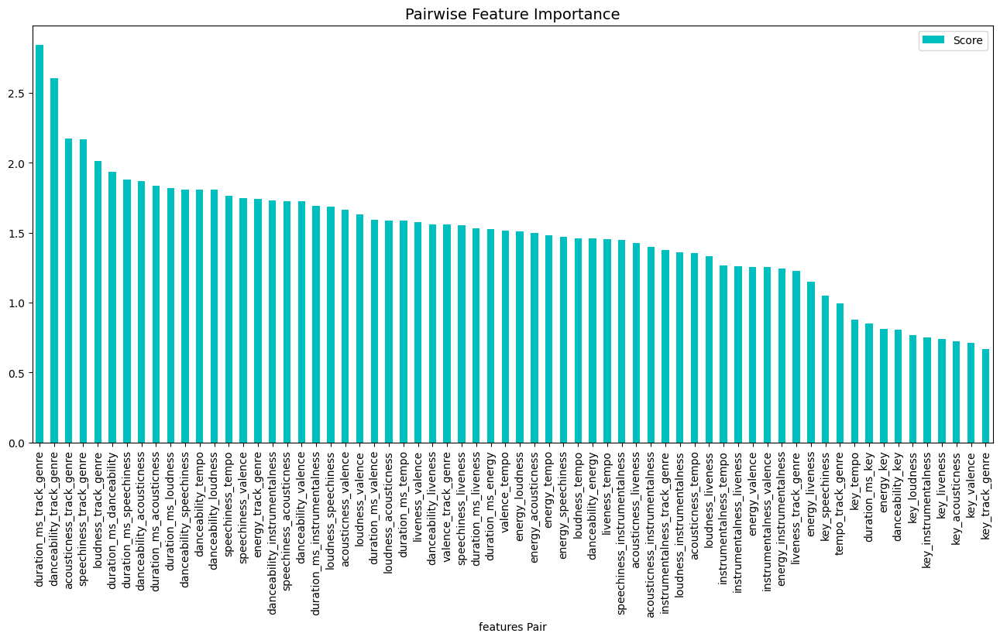

In [ ]:
print(get_feature_imp_plot(method="PredictionValuesChange"))

print(get_feature_imp_plot(method="LossFunctionChange"))

fi = model.get_feature_importance(Pool(X_test, label=y_test,cat_features=categorical_features_indices),
                                                                     type="Interaction")

fi_new = []
for k,item in enumerate(fi):
    first = X_test.dtypes.index[fi[k][0]]
    second = X_test.dtypes.index[fi[k][1]]
    if first != second:
        fi_new.append([first + "_" + second, fi[k][2]])

feature_score = pd.DataFrame(fi_new,columns=['Feature-Pair','Score'])

feature_score = feature_score.sort_values(by='Score', ascending=False, inplace=False, kind='quicksort', na_position='last')
plt.rcParams["figure.figsize"] = (16,7)
ax = feature_score.plot('Feature-Pair', 'Score', kind='bar', color='c')
ax.set_title("Pairwise Feature Importance", fontsize = 14)
ax.set_xlabel("features Pair")
plt.show()

In [ ]:
from catboost import Pool, cv

params = {"iterations": 800,
          "depth": 8,
          "loss_function": "Logloss",
          "verbose": False}

scores = cv(test_dataset,
            params,
            fold_count=5,
            plot="True")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Training on fold [0/5]

bestTest = 0.4475915
bestIteration = 799

Training on fold [1/5]

bestTest = 0.4531492558
bestIteration = 799

Training on fold [2/5]

bestTest = 0.4530666369
bestIteration = 799

Training on fold [3/5]

bestTest = 0.4409488215
bestIteration = 799

Training on fold [4/5]

bestTest = 0.4597720575
bestIteration = 799



In [ ]:
scores

In [ ]:
# res = model.calc_feature_statistics(train_dataset,
#                                     feature=[10],
#                                     plot=True)


model.save_model('/content/drive/MyDrive/online learning/projects/spotify_random_forest/music_model',
           format="cbm",
           export_parameters=None,
           pool=train_dataset)

In [ ]:
res

{10: {'borders': array([ 58.608   ,  64.167   ,  67.056   ,  69.361   ,  71.442   ,
          72.9005  ,  75.0665  ,  76.4955  ,  77.0255  ,  77.4935  ,
          78.0125  ,  78.7625  ,  80.9875  ,  81.4945  ,  82.0045  ,
          82.456   ,  82.986496,  83.5245  ,  84.89751 ,  85.2565  ,
          86.011   ,  86.9545  ,  87.391   ,  87.9245  ,  88.0455  ,
          88.816   ,  89.4695  ,  89.957504,  90.43851 ,  90.9975  ,
          91.5625  ,  91.98151 ,  92.2095  ,  92.5965  ,  93.173996,
          93.8545  ,  94.0085  ,  94.998505,  95.02251 ,  95.1375  ,
          96.0065  ,  96.876495,  97.03551 ,  97.5615  ,  97.9875  ,
          98.847   ,  99.281   ,  99.893   ,  99.9785  , 100.0005  ,
         100.01849 , 100.06149 , 100.4305  , 101.486   , 101.9845  ,
         102.093   , 103.0435  , 103.653   , 104.001495, 104.169495,
         104.9005  , 104.9975  , 105.0475  , 105.538   , 105.99249 ,
         106.997   , 107.42551 , 108.054504, 109.24249 , 109.8795  ,
         109.9845  